In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
import torch
import os
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from torchvision.datasets import ImageFolder
import torchvision.transforms as T
from torchvision.utils import make_grid, save_image
from tqdm import tqdm
from PIL import Image
from torch.optim import Adam

In [2]:
DIR = "/kaggle/input/animefacedataset"
IMAGE_SIZE = (64,64)
LATENT_SIZE = 128

In [3]:
ds = ImageFolder(DIR,transform=T.Compose([
    T.Resize(size=IMAGE_SIZE),
    T.ToTensor(),
    T.Normalize(mean=0,std=1)
]))

image_ds = DataLoader(ds,batch_size=256,num_workers=3,pin_memory=True,shuffle=True)

In [4]:
def show_images(batch):
    fig,ax = plt.subplots(figsize=(8,8))
    ax.axis("off")
    ax.imshow(make_grid(batch[:64],nrow=8).permute(1,2,0))

In [5]:
def save_images(batch,name):
    batch = batch
    img = make_grid(batch,nrow=8).permute(1,2,0)
    save_image(img,name)

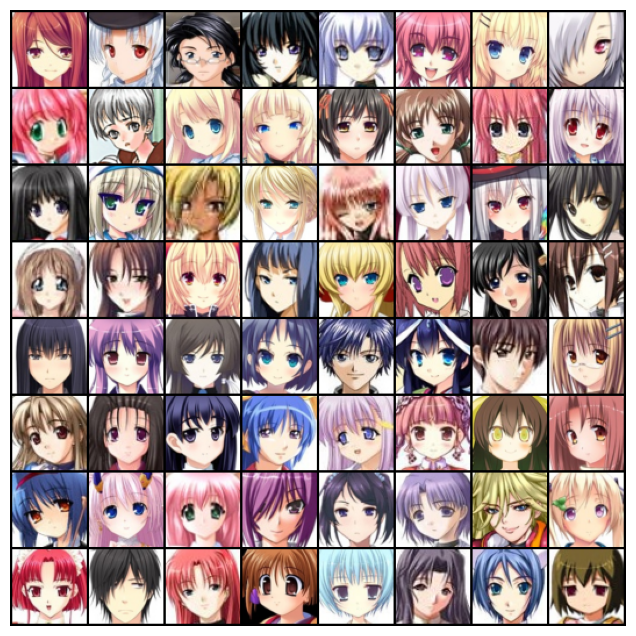

In [6]:
for img, _ in image_ds:
    show_images(img)
    break

In [7]:
def get_device():
    if(torch.cuda.is_available()):
        return torch.device("cuda")
    return torch.device("cpu")

device = get_device()
device

device(type='cuda')

In [8]:
class GPUDataLoader():
    def __init__(self,ds,device):
        self.ds = ds
        self.device = device

    def __len__(self):
        return len(self.ds)

    def __iter__(self):
        for img, _ in self.ds:
            yield img.to(self.device)

In [9]:
gpu_data_loader = GPUDataLoader(image_ds,device)

In [10]:
Discriminator = nn.Sequential(
            nn.Conv2d(3,64,padding=1,kernel_size=4,stride=2),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),
            # 64,32,32
            
            nn.Conv2d(64,128,padding=1,kernel_size=4,stride=2),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            # 128,16,16
            
            nn.Conv2d(128,256,padding=1,kernel_size=4,stride=2),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            # 256, 8, 8
            
            nn.Conv2d(256,512,padding=1,kernel_size=4,stride=2),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            # 512,4,4

            nn.Conv2d(512,1,padding=0,kernel_size=4,stride=1),
            # 1,1,1

            nn.Flatten(), # 1
            nn.Sigmoid() # 1
        )

In [11]:
Generator = nn.Sequential(
            nn.ConvTranspose2d(128,512,kernel_size=4,stride=1,padding=0),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            # 512,4,4

            nn.ConvTranspose2d(512,256,kernel_size=4,stride=2,padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            # 256,8,8

            nn.ConvTranspose2d(256,128,kernel_size=4,stride=2,padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            # 128,16,16

            nn.ConvTranspose2d(128,64,kernel_size=4,stride=2,padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            # 64,32,32

            nn.ConvTranspose2d(64,3,kernel_size=4,stride=2,padding=1), # 3,64,64
            nn.Tanh()            
        )

In [12]:
class GAN():
    def __init__(self,gen,dis):
        self.gen = gen
        self.dis = dis

    def train_discriminator(self,real_images,opt_d):
        opt_d.zero_grad()
        
        batch_size = len(real_images)
        real_pred = self.dis(real_images)
        real_target = torch.ones(batch_size,1,device=device)
        real_loss = F.binary_cross_entropy(real_pred,real_target)
        real_score = torch.mean(real_pred).item()
        
        latent = torch.randn(batch_size,LATENT_SIZE,1,1,device=device)
        fake_images = self.gen(latent)
        fake_pred = self.dis(fake_images)
        fake_target = torch.zeros(batch_size,1,device=device)
        fake_loss =F.binary_cross_entropy(fake_pred,fake_target)
        fake_score = torch.mean(fake_pred).item()
        
        loss = fake_loss + real_loss
        loss.backward()
        opt_d.step()
        
        return loss.item(), real_score, fake_score

    def train_generator(self,opt_g):
        opt_g.zero_grad()
        batch_size = 256
        latent = torch.randn(batch_size,LATENT_SIZE,1,1,device=device)
        fake_images = self.gen(latent)
        pred = self.dis(fake_images)
        target = torch.ones(batch_size,1,device=device)
        loss = F.binary_cross_entropy(pred,target)
        loss.backward()

        opt_g.step()
        return loss.item()
        
    def fit(self,epochs):
        torch.cuda.empty_cache()
        opt_d = Adam(self.dis.parameters(),lr=0.0002,betas=(0.5,0.999))
        opt_g = Adam(self.gen.parameters(),lr=0.0002,betas=(0.5,0.999))
        latent = torch.randn(64,LATENT_SIZE,1,1,device=device)
        
        for i in range(epochs):
            n = len(gpu_data_loader)
            for item in tqdm(gpu_data_loader):
                loss_d, real_score, fake_score = self.train_discriminator(item,opt_d)
                loss_g = self.train_generator(opt_g)
                
            img = self.gen(latent).cpu()
            print(f"Epoch - {i+1} Loss_d: {loss_d} Loss_g: {loss_g} Real_score: {real_score} Fake_score: {fake_score}")
            show_images(img)  

In [13]:
gen = Generator.to(device,non_blocking=True)
dis = Discriminator.to(device,non_blocking=True)

100%|██████████| 249/249 [01:54<00:00,  2.17it/s]


Epoch - 1 Loss_d: 0.30230286717414856 Loss_g: 2.3494133949279785 Real_score: 0.8708051443099976 Fake_score: 0.13065053522586823


100%|██████████| 249/249 [00:48<00:00,  5.11it/s]


Epoch - 2 Loss_d: 0.16768670082092285 Loss_g: 3.7964277267456055 Real_score: 0.8978886008262634 Fake_score: 0.04151322692632675


100%|██████████| 249/249 [00:48<00:00,  5.09it/s]


Epoch - 3 Loss_d: 0.623308539390564 Loss_g: 3.2347967624664307 Real_score: 0.7269557118415833 Fake_score: 0.20058561861515045


100%|██████████| 249/249 [00:48<00:00,  5.11it/s]


Epoch - 4 Loss_d: 3.9556047916412354 Loss_g: 5.222905158996582 Real_score: 0.03529505431652069 Fake_score: 0.0002142918820027262


100%|██████████| 249/249 [00:48<00:00,  5.11it/s]


Epoch - 5 Loss_d: 0.255487859249115 Loss_g: 3.4812910556793213 Real_score: 0.8434931635856628 Fake_score: 0.05643964558839798


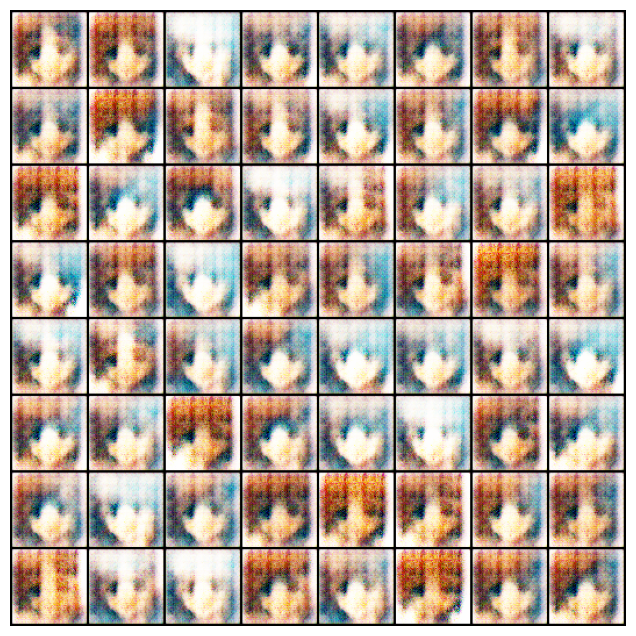

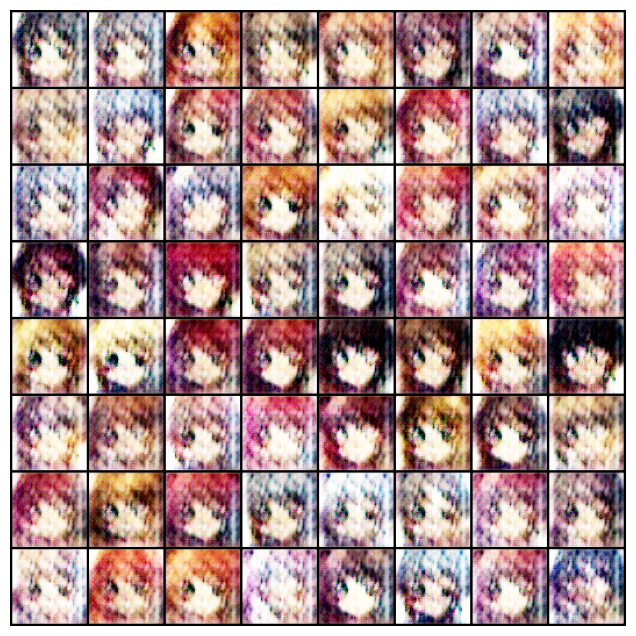

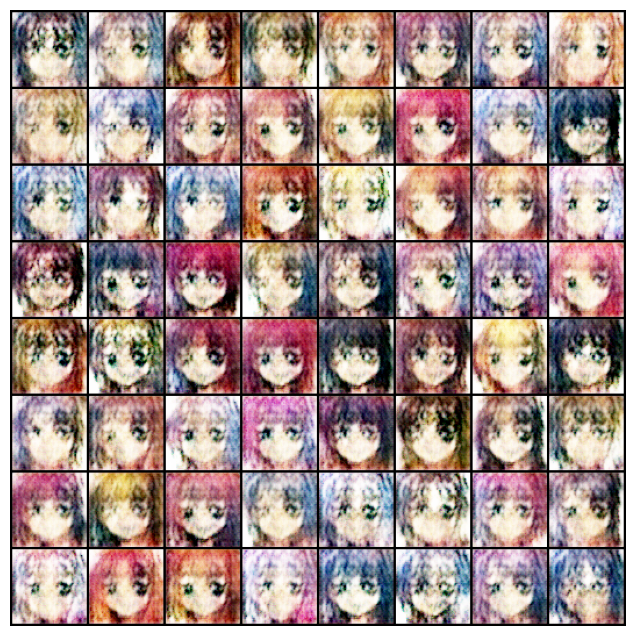

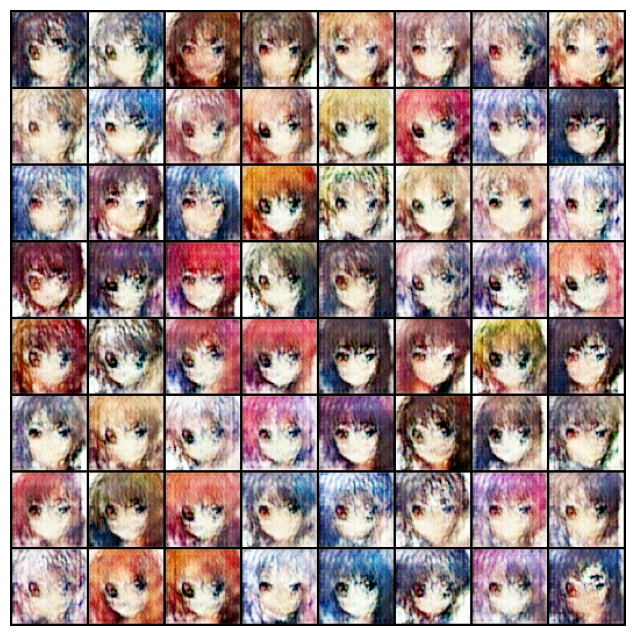

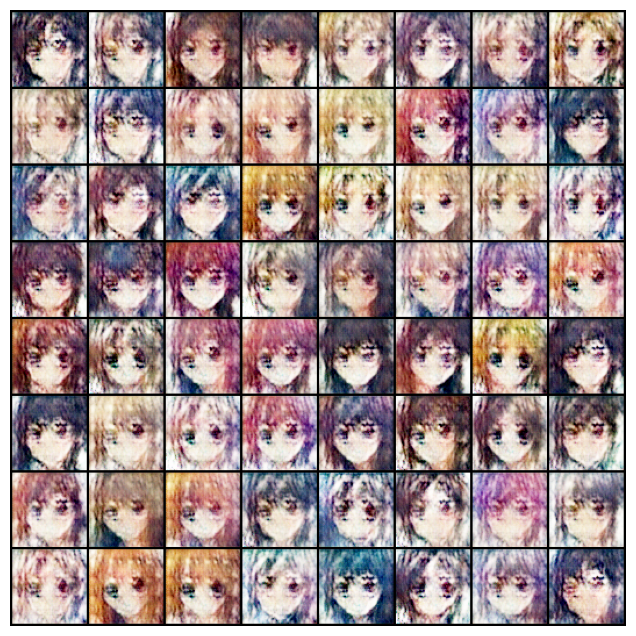

In [14]:
gan = GAN(gen,dis)
gan.fit(5)

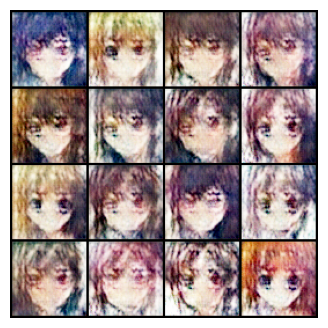

In [15]:
latent = torch.randn(16,LATENT_SIZE,1,1,device=device)
img = gan.gen(latent).cpu()
fig,ax = plt.subplots(figsize=(4,4))
ax.axis("off")
ax.imshow(make_grid(img,nrow=4).permute(1,2,0))

100%|██████████| 249/249 [00:48<00:00,  5.09it/s]


Epoch - 1 Loss_d: 0.5835766196250916 Loss_g: 11.975767135620117 Real_score: 0.9753211140632629 Fake_score: 0.40124502778053284


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 2 Loss_d: 0.18166634440422058 Loss_g: 5.689850807189941 Real_score: 0.9617704153060913 Fake_score: 0.12668825685977936


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 3 Loss_d: 0.09217997640371323 Loss_g: 5.083752632141113 Real_score: 0.9340294003486633 Fake_score: 0.013333410024642944


100%|██████████| 249/249 [00:48<00:00,  5.11it/s]


Epoch - 4 Loss_d: 0.5084558129310608 Loss_g: 5.0069379806518555 Real_score: 0.6761939525604248 Fake_score: 0.00018191309936810285


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 5 Loss_d: 0.006416514981538057 Loss_g: 11.82215690612793 Real_score: 0.9946778416633606 Fake_score: 0.0008757234318181872


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 6 Loss_d: 0.14610157907009125 Loss_g: 4.793122291564941 Real_score: 0.9499626755714417 Fake_score: 0.08566734194755554


100%|██████████| 249/249 [00:49<00:00,  5.06it/s]


Epoch - 7 Loss_d: 0.13957515358924866 Loss_g: 4.555196762084961 Real_score: 0.8885746002197266 Fake_score: 0.0058326744474470615


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 8 Loss_d: 0.15393000841140747 Loss_g: 6.238920211791992 Real_score: 0.9685471653938293 Fake_score: 0.10515973716974258


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 9 Loss_d: 0.06663119047880173 Loss_g: 5.448030471801758 Real_score: 0.9621951580047607 Fake_score: 0.022763051092624664


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 10 Loss_d: 0.05093539133667946 Loss_g: 5.385870933532715 Real_score: 0.985266923904419 Fake_score: 0.034904319792985916


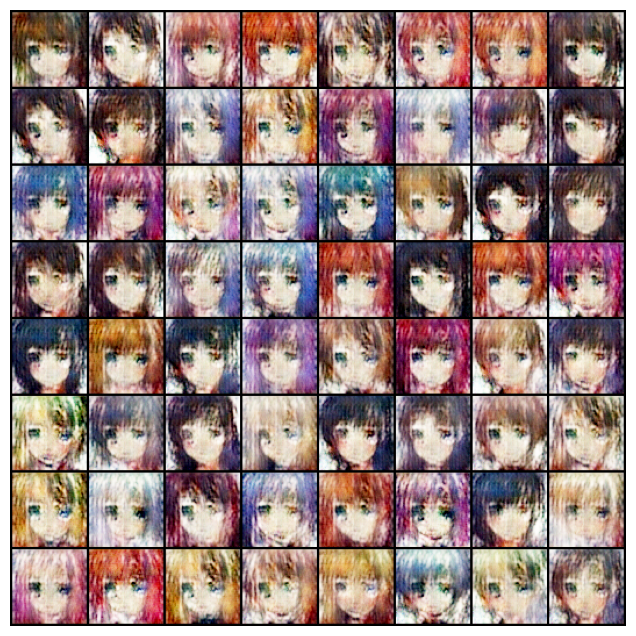

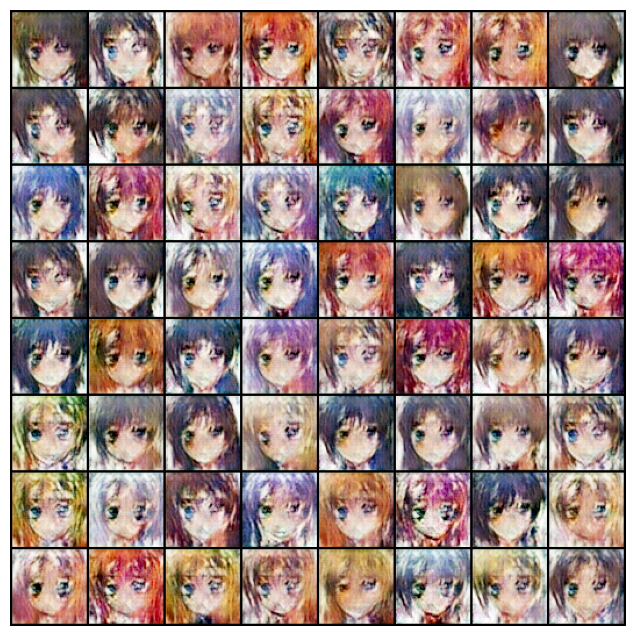

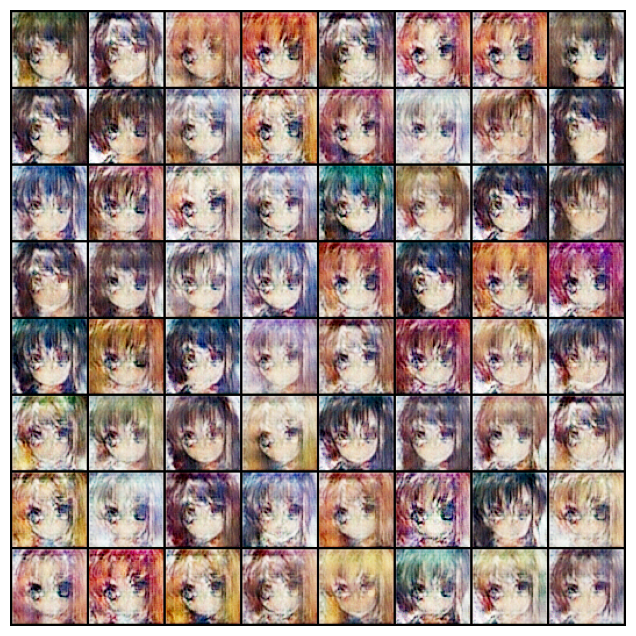

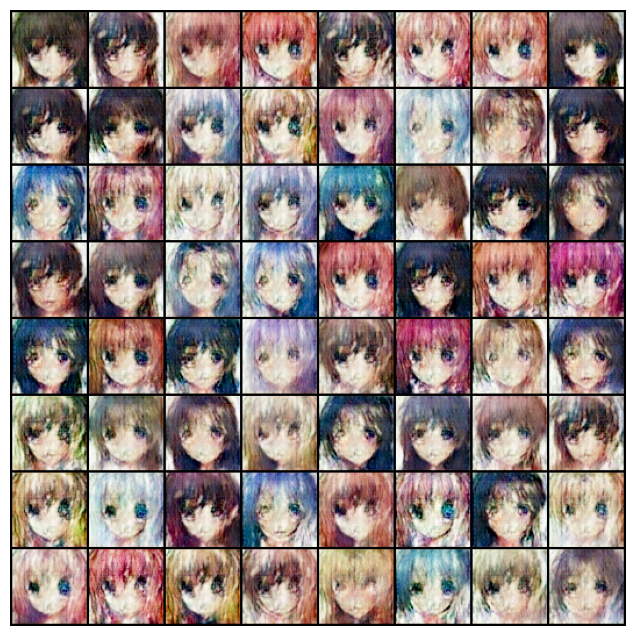

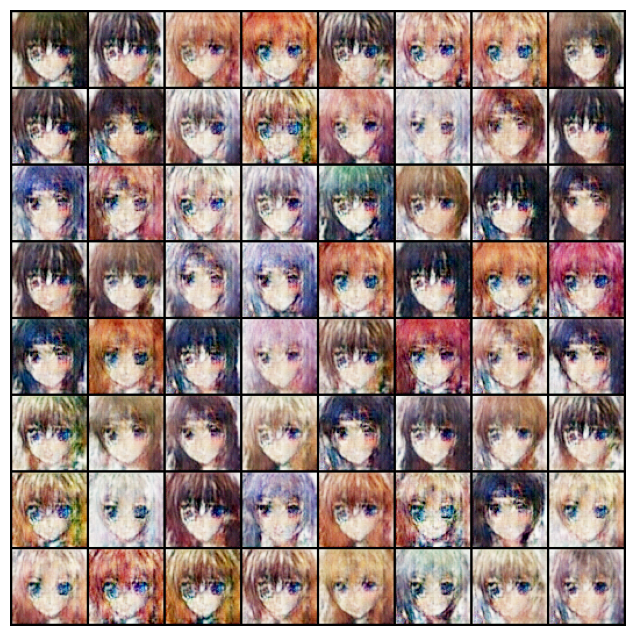

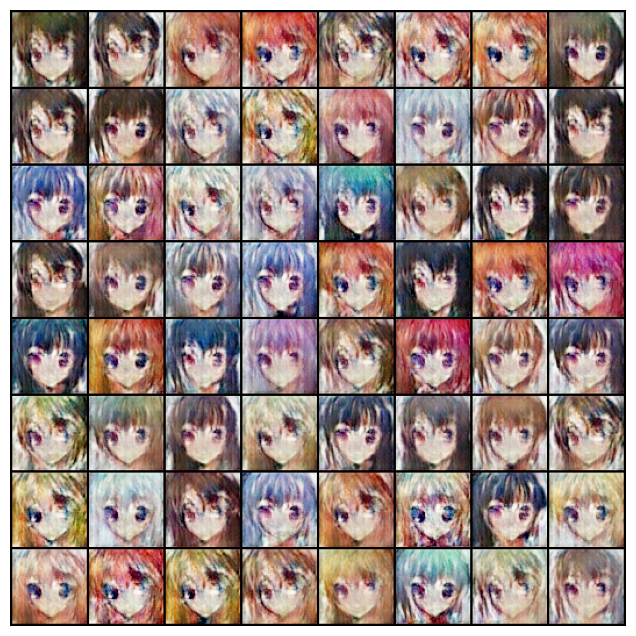

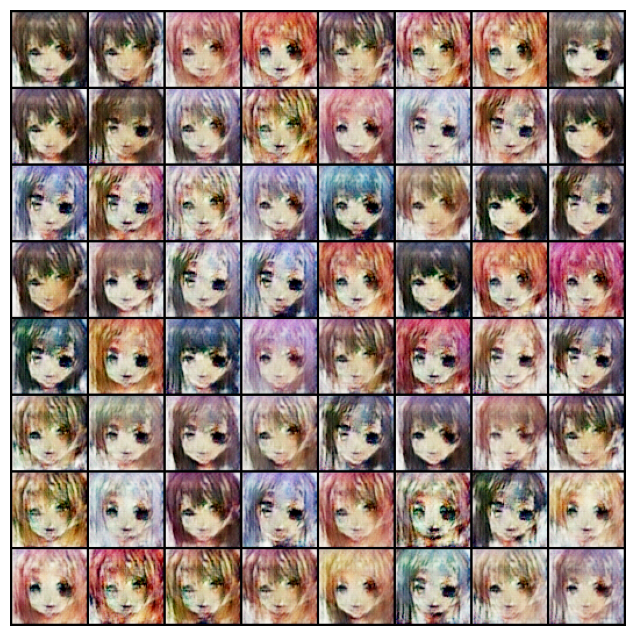

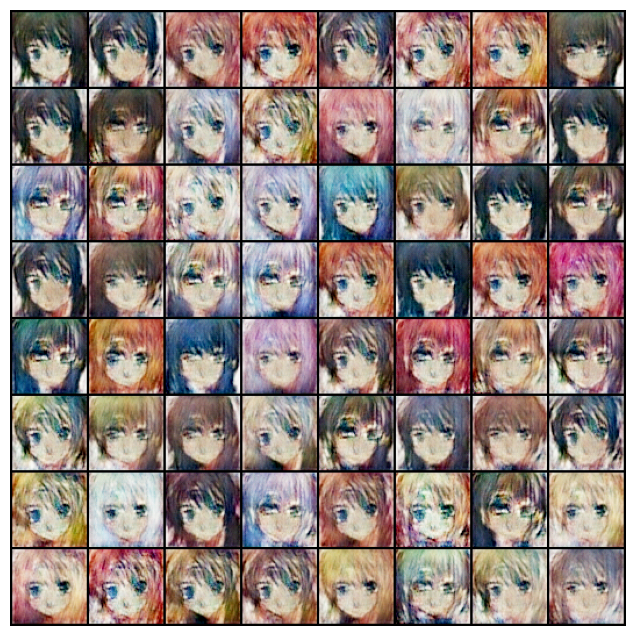

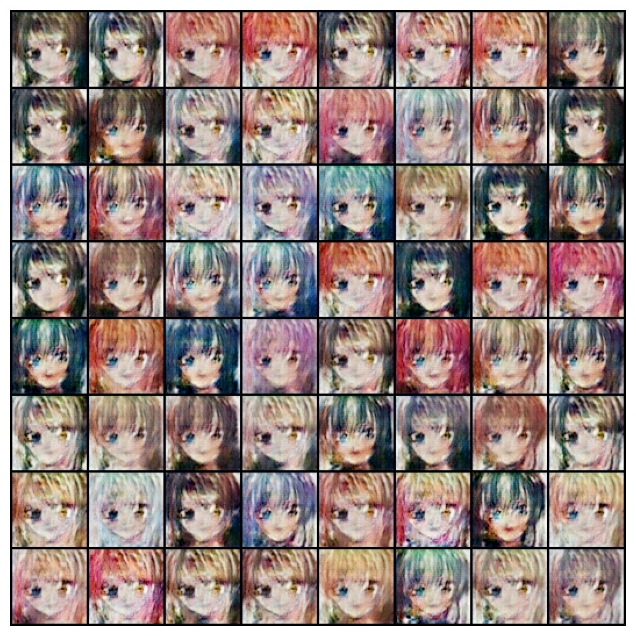

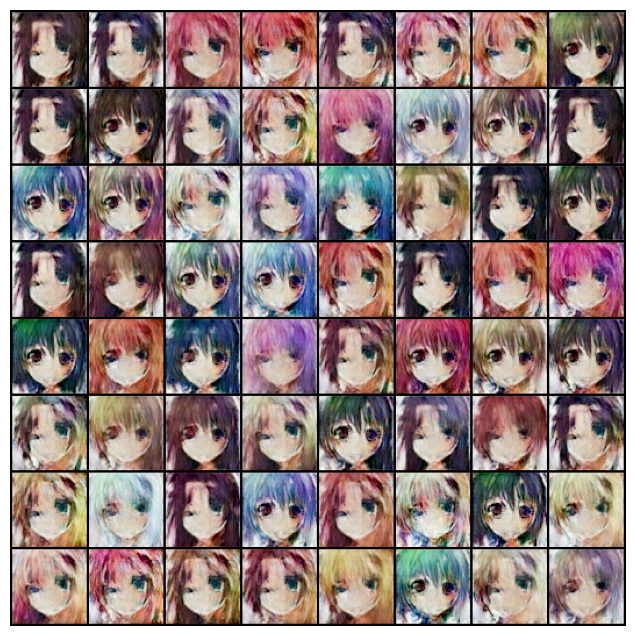

In [16]:
gan.fit(10)

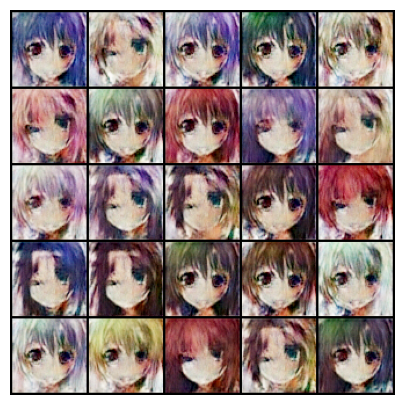

In [18]:
latent = torch.randn(25,LATENT_SIZE,1,1,device=device)
img = gan.gen(latent).cpu()
fig,ax = plt.subplots(figsize=(5,5))
ax.axis("off")
ax.imshow(make_grid(img,nrow=5).permute(1,2,0))

100%|██████████| 249/249 [00:49<00:00,  4.98it/s]


Epoch - 1 Loss_d: 0.09519685804843903 Loss_g: 5.932753562927246 Real_score: 0.9853602647781372 Fake_score: 0.07414505630731583


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 2 Loss_d: 0.06952046602964401 Loss_g: 7.88621711730957 Real_score: 0.946282148361206 Fake_score: 0.007456675637513399


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 3 Loss_d: 0.11620686203241348 Loss_g: 7.064371585845947 Real_score: 0.9911802411079407 Fake_score: 0.10005415230989456


100%|██████████| 249/249 [00:48<00:00,  5.11it/s]


Epoch - 4 Loss_d: 0.06311732530593872 Loss_g: 5.135529518127441 Real_score: 0.9658955931663513 Fake_score: 0.02001870423555374


100%|██████████| 249/249 [00:48<00:00,  5.11it/s]


Epoch - 5 Loss_d: 0.09632638841867447 Loss_g: 5.4105448722839355 Real_score: 0.9596466422080994 Fake_score: 0.045505888760089874


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 6 Loss_d: 0.03362113982439041 Loss_g: 4.175189971923828 Real_score: 0.985058069229126 Fake_score: 0.017983147874474525


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 7 Loss_d: 0.057602494955062866 Loss_g: 4.797101020812988 Real_score: 0.9752656817436218 Fake_score: 0.030997931957244873


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 8 Loss_d: 0.023787986487150192 Loss_g: 5.119360446929932 Real_score: 0.988682746887207 Fake_score: 0.011741635389626026


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 9 Loss_d: 0.09823926538228989 Loss_g: 5.500885486602783 Real_score: 0.9351842403411865 Fake_score: 0.017231643199920654


100%|██████████| 249/249 [00:48<00:00,  5.10it/s]


Epoch - 10 Loss_d: 0.022115016356110573 Loss_g: 5.245749473571777 Real_score: 0.9849353432655334 Fake_score: 0.00648017693310976


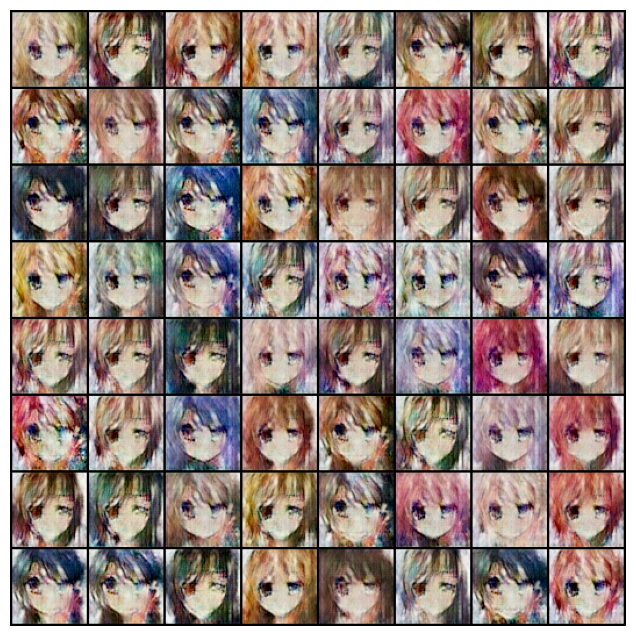

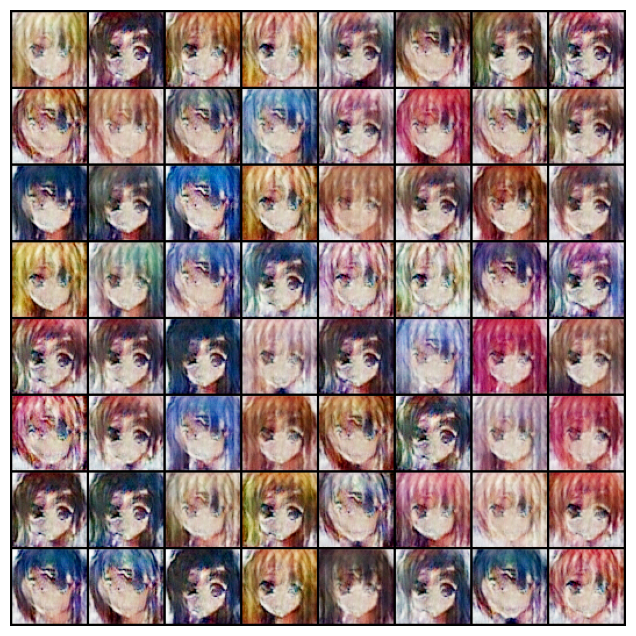

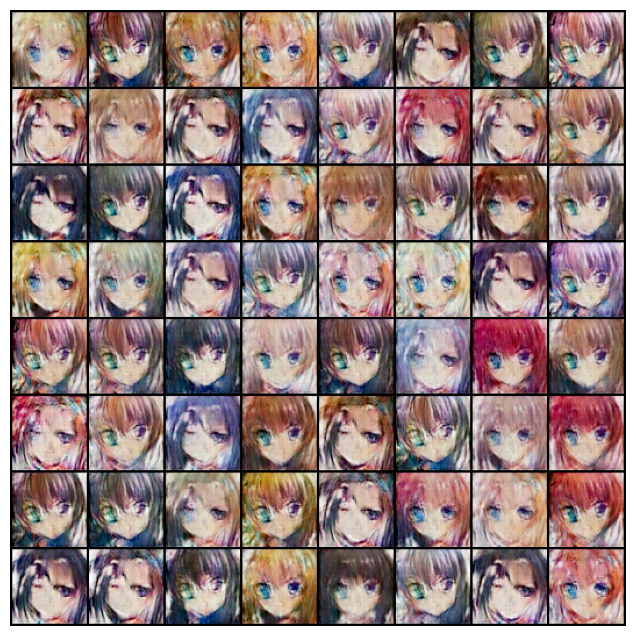

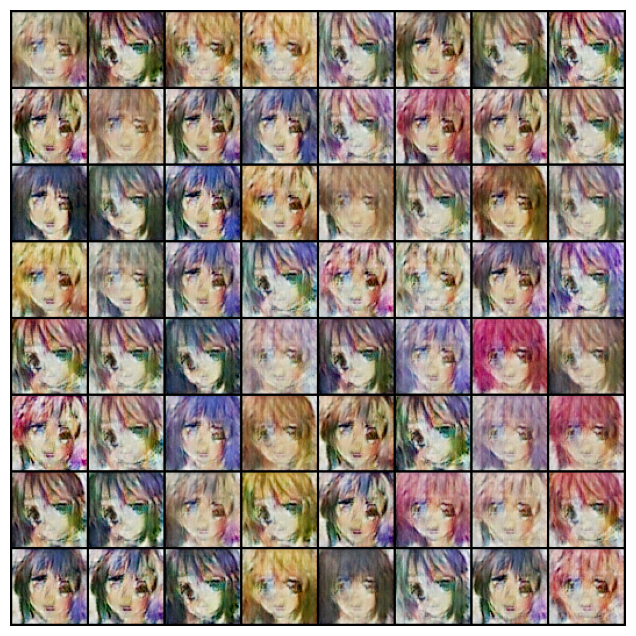

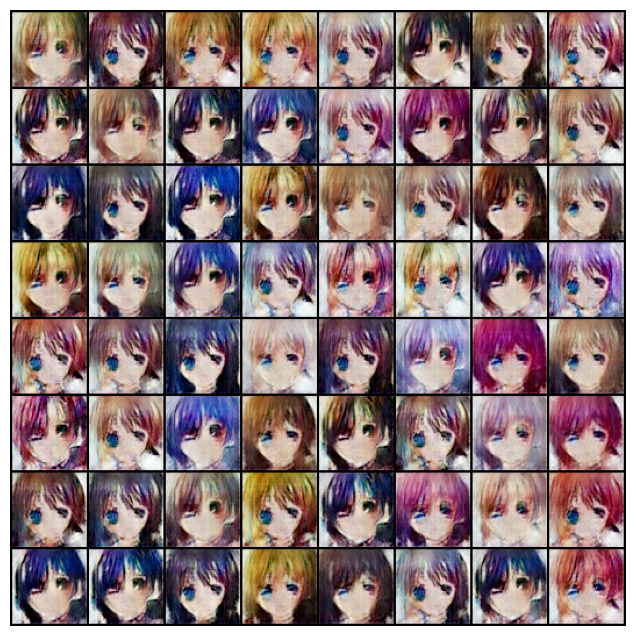

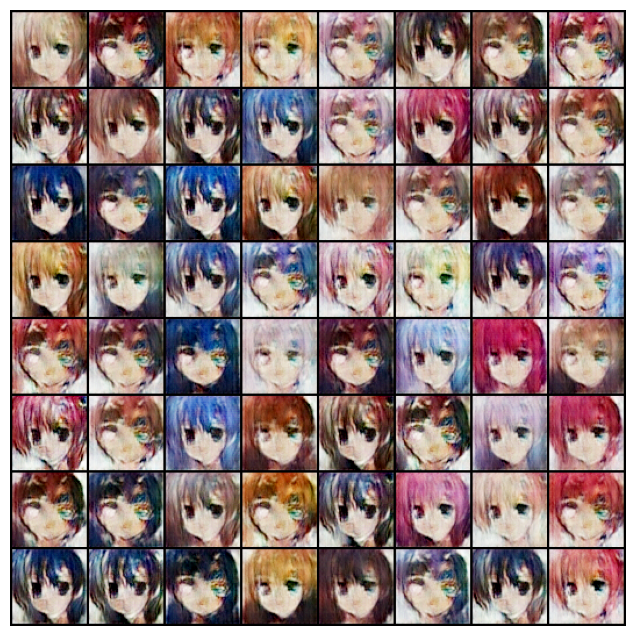

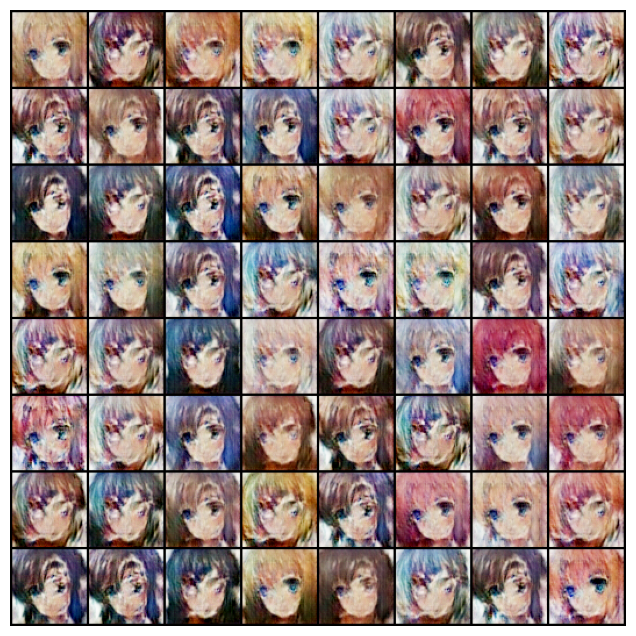

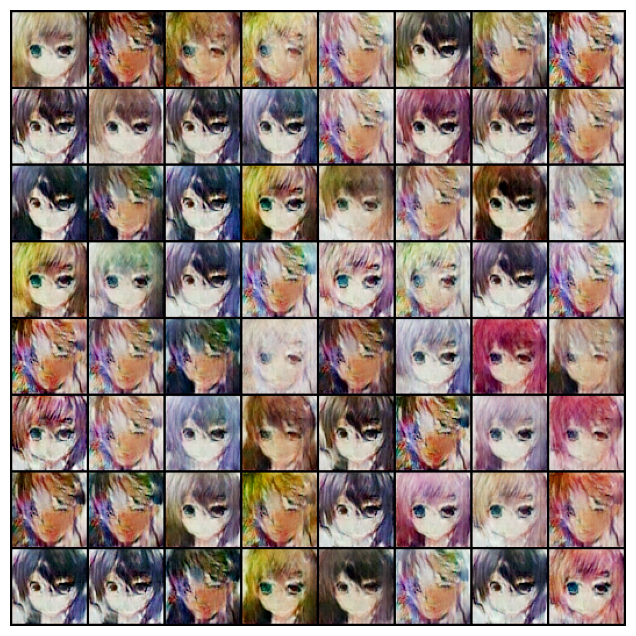

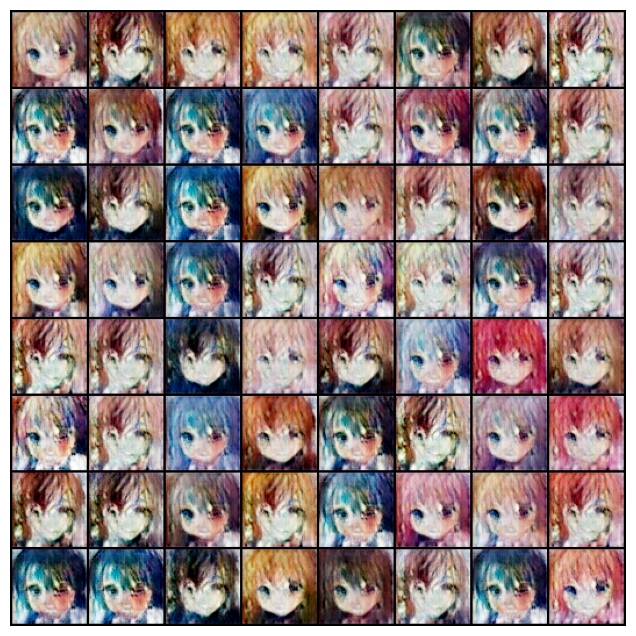

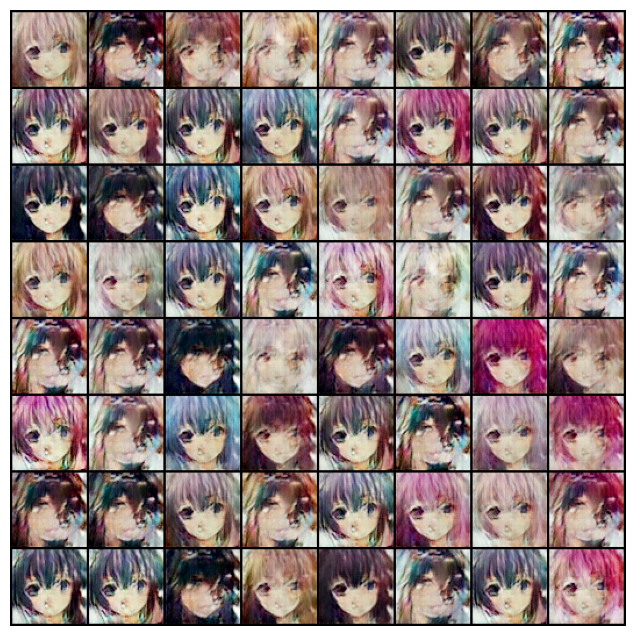

In [21]:
gan.fit(10)

In [ ]:
torch.save(gan.gen.state_dict(),"generator.h5")
torch.save(gan.dis.state_dict(),"discriminator.h5")

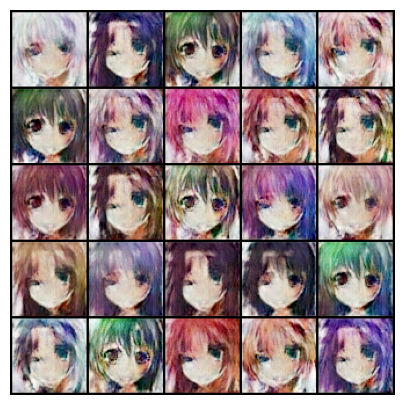

[0.07752113 0.07416988 0.09648202 0.01975067 0.08817141 0.24500747
 0.04580069 0.18121524 0.16227856 0.07389567 0.10935741 0.07518762
 0.04650533 0.09889375 0.12381142 0.04835958 0.16548002 0.05517295
 0.11602945 0.05169878 0.09746109 0.09393451 0.13667761 0.05736057
 0.06322532]


In [29]:
Generator.load_state_dict(torch.load("./generator.h5",weights_only=True))
Discriminator.load_state_dict(torch.load("./discriminator.h5",weights_only=True))

Generator.eval()
Discriminator.eval()

latent = torch.randn(25,128,1,1,device=device)
img = Generator(latent)
fig,ax = plt.subplots(figsize=(5,5))
ax.axis("off")
ax.imshow(make_grid(img.cpu(),nrow=5).permute(1,2,0))
plt.show()

with torch.no_grad():
    print(Discriminator(img).cpu().flatten().numpy())